In [1]:
import torch
import torch.nn as nn 
import torch.nn.functional as F

from PIL import Image
import matplotlib.pyplot as plt

import numpy as np

from tqdm import tqdm

import gc


In [2]:
def set_seed(seed):
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
        torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

set_seed(42)

In [3]:
def create_window(window_size, channel):
    def gaussian(window_size, sigma):
        gauss = torch.exp(torch.tensor([-(x - window_size//2)**2/float(2*sigma**2) for x in range(window_size)]))
        return gauss/gauss.sum()

    _1D_window = gaussian(window_size, 1.5).unsqueeze(1)
    _2D_window = _1D_window.mm(_1D_window.t()).float().unsqueeze(0).unsqueeze(0)
    window = torch.autograd.Variable(_2D_window.expand(channel, 1, window_size, window_size).contiguous())

    return window

def ssim(img1, img2, window_size=11, size_average=True):


    # Assuming the image is of shape [N, C, H, W]
    (_, _, channel) = img1.size()

    img1 = img1.unsqueeze(0).permute(0, 3, 1, 2)
    img2 = img2.unsqueeze(0).permute(0, 3, 1, 2)


    # Parameters for SSIM
    C1 = 0.01**2
    C2 = 0.03**2

    window = create_window(window_size, channel)

    if img1.is_cuda:
        window = window.cuda(img1.get_device())
    window = window.type_as(img1)

    mu1 = F.conv2d(img1, window, padding=window_size//2, groups=channel)
    mu2 = F.conv2d(img2, window, padding=window_size//2, groups=channel)
    mu1_sq = mu1.pow(2)
    mu2_sq = mu2.pow(2)
    mu1_mu2 = mu1 * mu2

    sigma1_sq = F.conv2d(img1*img1, window, padding=window_size//2, groups=channel) - mu1_sq
    sigma2_sq = F.conv2d(img2*img2, window, padding=window_size//2, groups=channel) - mu2_sq
    sigma12 = F.conv2d(img1*img2, window, padding=window_size//2, groups=channel) - mu1_mu2

    SSIM_numerator = ((2*mu1_mu2 + C1)*(2*sigma12 + C2))
    SSIM_denominator = ((mu1_sq + mu2_sq + C1)*(sigma1_sq + sigma2_sq + C2))
    SSIM = SSIM_numerator / SSIM_denominator

    return torch.clamp((1 - SSIM) / 2, 0, 1)

def d_ssim_loss(img1, img2, window_size=11, size_average=True):
    return ssim(img1, img2, window_size, size_average).mean()

# Combined Loss
def combined_loss(pred, target, lambda_param=0.5):
    l1loss = nn.L1Loss()
    return (1 - lambda_param) * l1loss(pred, target) + lambda_param * d_ssim_loss(pred, target)

In [4]:
LEARNING_RATE = 0.01

N_PRIMARY_SAMPLES = 1000
N_BACKUP_SAMPLES = 0

N_SAMPLES = N_PRIMARY_SAMPLES + N_BACKUP_SAMPLES

IMAGE_SIZE = [256, 256, 3]

In [5]:
# display_var = lambda name, x: print(f"{name}: {x.mean()} {x.std()} {x.min()} {x.max()}")

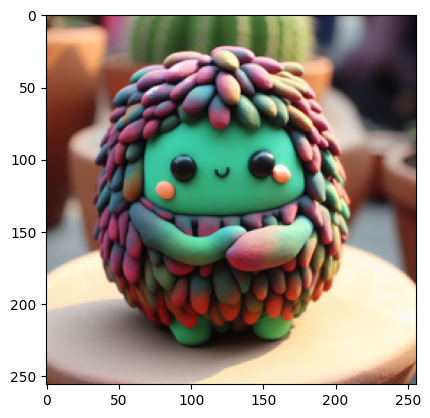

In [6]:
def load_image(image_path):
    image = Image.open(image_path)
    image = image.resize((IMAGE_SIZE[0],IMAGE_SIZE[1]))
    image = image.convert('RGB')
    image = np.array(image)
    image = image / 255.0
    h, w, c = image.shape
    return image, (h, w, c)

image, shape = load_image('Image-01.png')
plt.imshow(image)

In [7]:
device = torch.device('cuda')
image_tensor = torch.tensor(image, dtype=torch.float32, device=device)
image_tensor.shape

torch.Size([256, 256, 3])

### Get Coordinates in the Image

Load coordinates in the images to be used for testing purposes

In [8]:
coords = np.random.randint(0, [shape[0], shape[1]], size=(N_SAMPLES, 2))
print(coords.min(axis=0))
print(coords.max(axis=0))
# make it a tensor
coords = torch.tensor(coords, device=device)
coords.shape

[0 0]
[255 255]


torch.Size([1000, 2])

In [9]:
random_pixels = image_tensor[coords[:, 0], coords[:, 1]]
random_pixels.shape

torch.Size([1000, 3])

In [10]:
coords_norm = coords / torch.tensor([shape[0]-1, shape[1]-1], device=device).float()
coords_norm = coords_norm * 2 - 1
coords_norm.shape, coords_norm.min(), coords_norm.max()

(torch.Size([1000, 2]),
 tensor(-1., device='cuda:0'),
 tensor(1., device='cuda:0'))

In [11]:
colour_values = image_tensor[coords[:, 0], coords[:, 1]]
# print(colour_values.mean(), colour_values.std(), colour_values.min(), colour_values.max())
# print(colour_values[:3, ...])
# colour_values = torch.logit(colour_values)
# print(colour_values.mean(), colour_values.std(), colour_values.min(), colour_values.max())
colour_values.shape, colour_values[:3, ...]

(torch.Size([1000, 3]),
 tensor([[0.1412, 0.0588, 0.0667],
         [0.3765, 0.1725, 0.1255],
         [0.2235, 0.7725, 0.6196]], device='cuda:0'))

In [12]:
sigma_values = torch.rand(N_SAMPLES, 2, device=device)
rho_values = 2 * torch.rand(N_SAMPLES, 1, device=device) - 1
alpha_values = torch.ones(N_SAMPLES, 1, device=device)*0.8
# display_var('sigma_values', sigma_values)
# display_var('rho_values', rho_values)
# display_var('alpha_values', alpha_values)

In [13]:
sigma_values = torch.logit(sigma_values)
rho_values = torch.atanh(rho_values)
alpha_values = torch.logit(alpha_values)
colour_values = torch.logit(colour_values)
coords_norm = torch.atanh(coords_norm)

W_values = torch.cat([sigma_values, rho_values, alpha_values, colour_values, coords_norm], dim=1)
W_values.shape

torch.Size([1000, 9])

In [14]:
W = nn.Parameter(W_values)
optimizer = torch.optim.Adam([W], lr=LEARNING_RATE)
loss_history = []

In [15]:
EPOCHS = 100
densification_interval = 10

In [16]:
def sample_gaussians(gaussian_variables, kernel_size=101):
    # pull the variables
    batch_size = gaussian_variables.shape[0]
    sigma_x = gaussian_variables[:, 0].view(batch_size, 1, 1)
    sigma_y = gaussian_variables[:, 1].view(batch_size, 1, 1)
    rho = gaussian_variables[:, 2].view(batch_size, 1, 1)
    alpha = gaussian_variables[:, 3].view(batch_size, 1)
    colors = gaussian_variables[:, 4:7]
    coords = gaussian_variables[:, 7:9]

    # fix the variables
    sigma_x = F.sigmoid(sigma_x)
    sigma_y = F.sigmoid(sigma_y)
    rho = F.tanh(rho)
    alpha = F.sigmoid(alpha)
    colors = F.sigmoid(colors)
    coords = F.tanh(coords)
    
    # weight the colors values with alpha
    colors = colors * alpha

    # get covariance
    covariance = torch.stack(
        [torch.stack([sigma_x**2, rho*sigma_x*sigma_y], dim=-1),
        torch.stack([rho*sigma_x*sigma_y, sigma_y**2], dim=-1)],
        dim=-2
    )

    determinant = (sigma_x**2) * (sigma_y**2) - (rho * sigma_x * sigma_y)**2
    if (determinant <= 0).any():
        raise ValueError("Covariance matrix must be positive semi-definite")

    inverse_covariance = torch.inverse(covariance)

    xx = torch.linspace(start=-5, end=5, steps=kernel_size, device=device)
    yy = torch.linspace(start=-5, end=5, steps=kernel_size, device=device)
    xx, yy = torch.meshgrid(xx, yy, indexing='ij')
    xx, yy = xx.unsqueeze(0), yy.unsqueeze(0)
    xy = torch.stack((xx, yy), dim=-1)

    z = torch.einsum('b...i,b...ij,b...j->b...', xy, -0.5 * inverse_covariance, xy)
    kernel = torch.exp(z) / (2 * torch.tensor(np.pi, device=device) * torch.sqrt(torch.det(covariance)).view(batch_size, 1, 1))
    
    kernel_max_1, _ = kernel.max(dim=-1, keepdim=True)  # Find max along the last dimension
    kernel_max_2, _ = kernel_max_1.max(dim=-2, keepdim=True)  # Find max along the second-to-last dimension
    kernel_normalized = kernel / kernel_max_2

    kernel_reshaped = kernel_normalized.repeat(1, 3, 1).view(batch_size * 3, kernel_size, kernel_size)
    kernel_rgb = kernel_reshaped.unsqueeze(0).reshape(batch_size, 3, kernel_size, kernel_size)

    pad_h = shape[0] - kernel_size
    pad_w = shape[1] - kernel_size
    if pad_h < 0 or pad_w < 0:
        raise ValueError("Kernel size should be smaller or equal to the image size.")
    
    padding = (pad_w // 2, pad_w // 2 + pad_w % 2,  # padding left and right
               pad_h // 2, pad_h // 2 + pad_h % 2)  # padding top and bottom
    kernel_rgb_padded = torch.nn.functional.pad(kernel_rgb, padding, "constant", 0)  

    b, c, h, w = kernel_rgb_padded.shape
    theta = torch.zeros(b, 2, 3, dtype=torch.float32, device=device)
    theta[:, 0, 0] = 1.0
    theta[:, 1, 1] = 1.0
    theta[:, :, 2] = coords

    grid = F.affine_grid(theta, size=(b, c, h, w), align_corners=True)
    kernel_rgb_padded_translated = F.grid_sample(kernel_rgb_padded, grid, align_corners=True)

    rgb_values_reshaped = colors.unsqueeze(-1).unsqueeze(-1)

    final_image_layers = rgb_values_reshaped * kernel_rgb_padded_translated
    final_image = final_image_layers.sum(dim=0)
    final_image = torch.clamp(final_image, 0, 1)
    final_image = final_image.permute(1,2,0)
    return final_image

  0%|          | 0/1000 [00:00<?, ?it/s]

Epoch 0 -> loss 0.07342950254678726


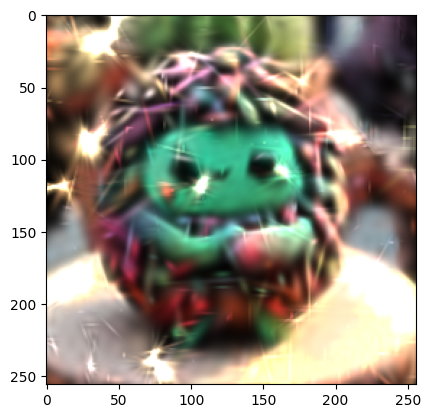

  1%|          | 10/1000 [00:03<06:03,  2.72it/s]

Epoch 10 -> loss 0.0681074932217598


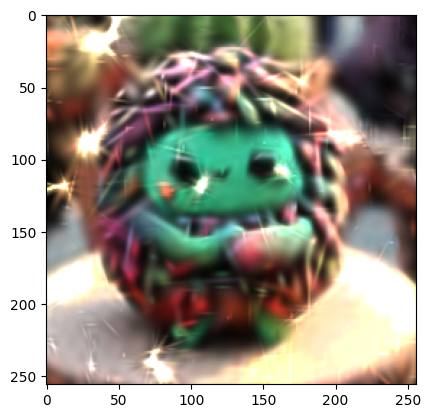

  2%|▏         | 20/1000 [00:07<06:04,  2.69it/s]

Epoch 20 -> loss 0.06364405900239944


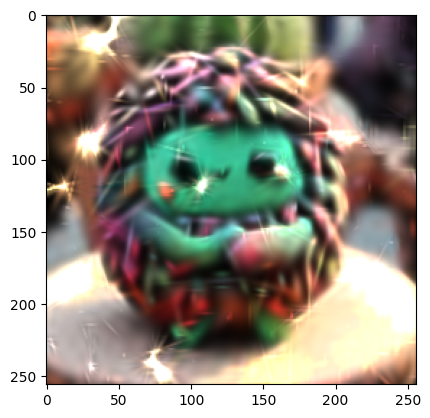

  3%|▎         | 30/1000 [00:11<06:02,  2.68it/s]

Epoch 30 -> loss 0.059728190302848816


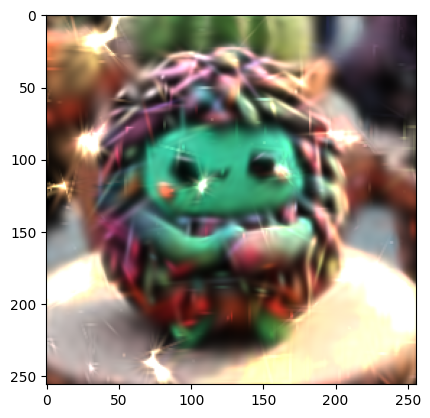

  4%|▍         | 40/1000 [00:15<05:57,  2.68it/s]

Epoch 40 -> loss 0.05637335032224655


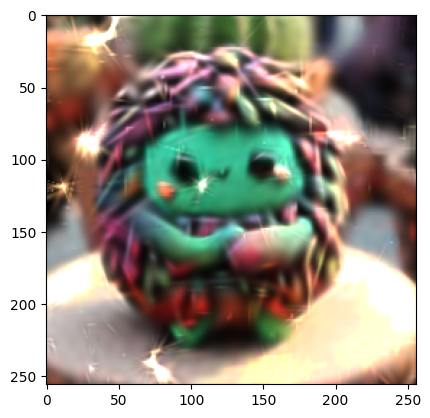

  5%|▌         | 50/1000 [00:19<05:54,  2.68it/s]

Epoch 50 -> loss 0.053378887474536896


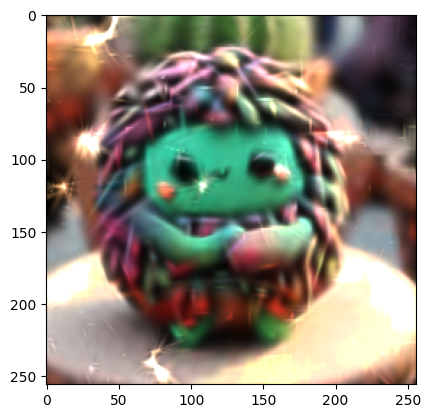

  6%|▌         | 60/1000 [00:23<05:52,  2.66it/s]

Epoch 60 -> loss 0.05078943073749542


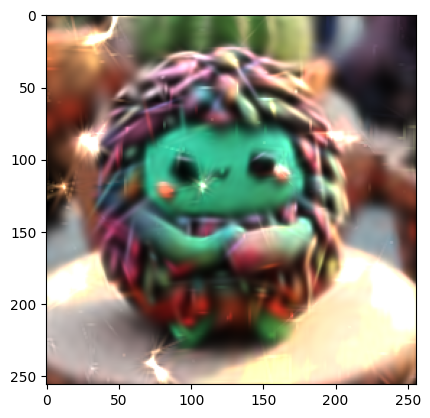

  7%|▋         | 70/1000 [00:27<05:40,  2.73it/s]

Epoch 70 -> loss 0.048578038811683655


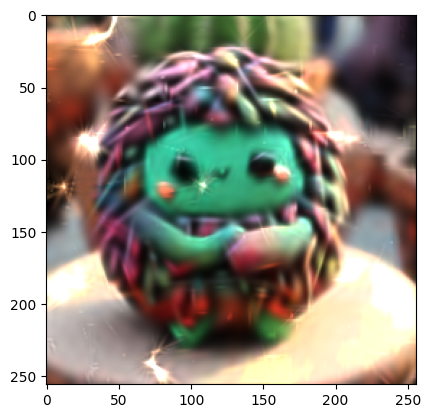

  8%|▊         | 80/1000 [00:30<05:34,  2.75it/s]

Epoch 80 -> loss 0.04658851772546768


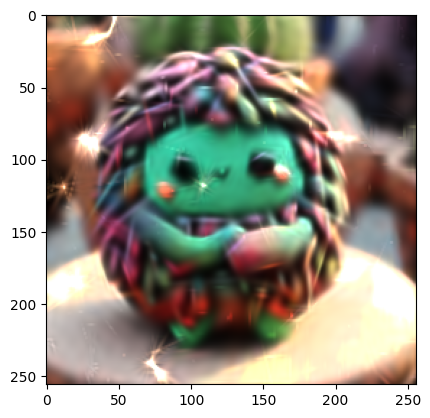

  9%|▉         | 90/1000 [00:34<05:29,  2.76it/s]

Epoch 90 -> loss 0.04492630064487457


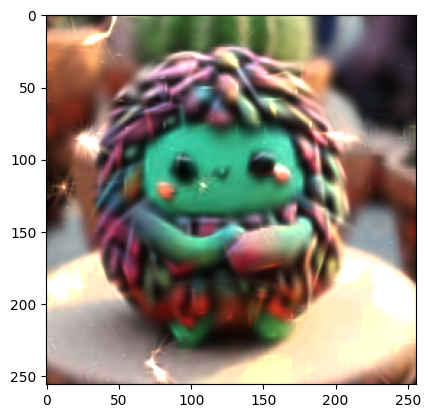

 10%|█         | 100/1000 [00:38<05:26,  2.76it/s]

Epoch 100 -> loss 0.04347236454486847


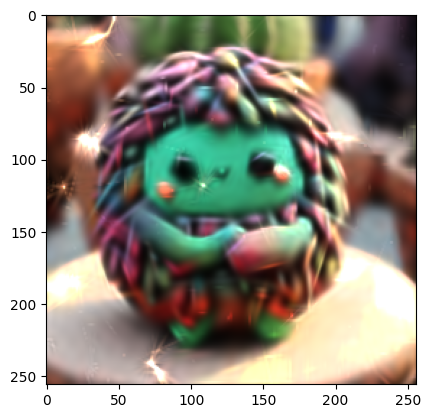

 11%|█         | 110/1000 [00:42<05:23,  2.75it/s]

Epoch 110 -> loss 0.04215347766876221


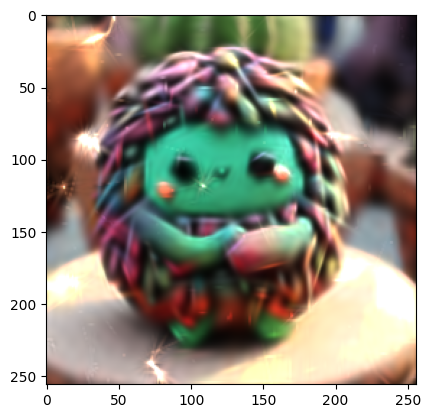

 12%|█▏        | 120/1000 [00:46<05:19,  2.75it/s]

Epoch 120 -> loss 0.04092278331518173


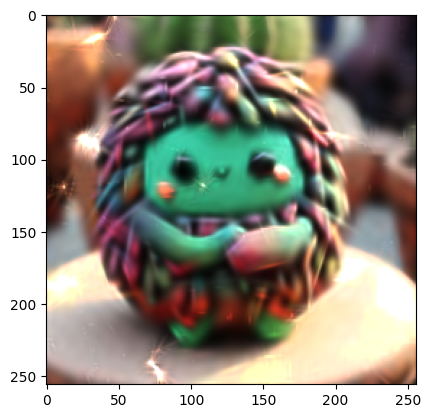

 13%|█▎        | 130/1000 [00:49<05:15,  2.75it/s]

Epoch 130 -> loss 0.03993996977806091


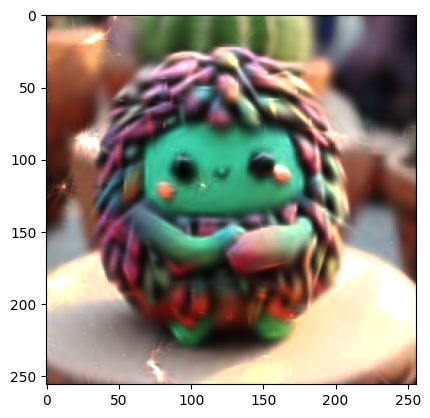

 14%|█▍        | 140/1000 [00:53<05:12,  2.75it/s]

Epoch 140 -> loss 0.03895668312907219


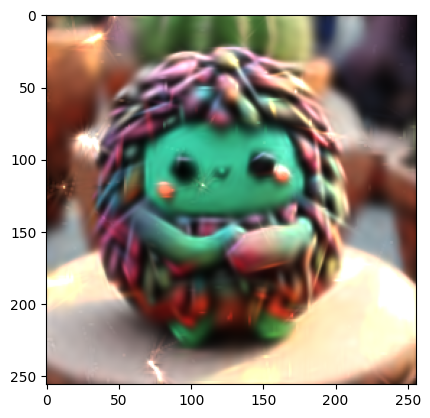

 15%|█▌        | 150/1000 [00:57<05:08,  2.75it/s]

Epoch 150 -> loss 0.03812173381447792


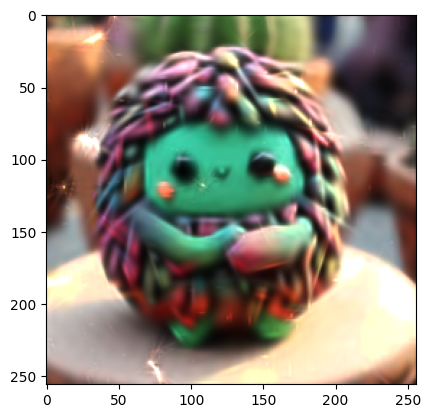

 16%|█▌        | 160/1000 [01:01<05:05,  2.75it/s]

Epoch 160 -> loss 0.03739814832806587


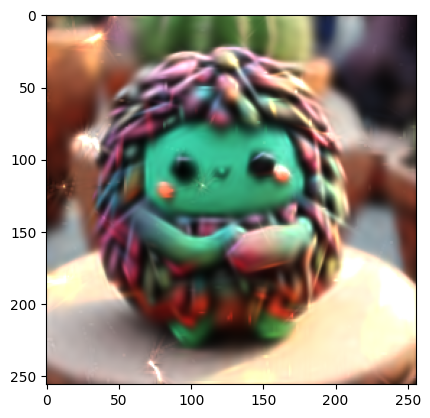

 17%|█▋        | 170/1000 [01:04<05:02,  2.75it/s]

Epoch 170 -> loss 0.03664737939834595


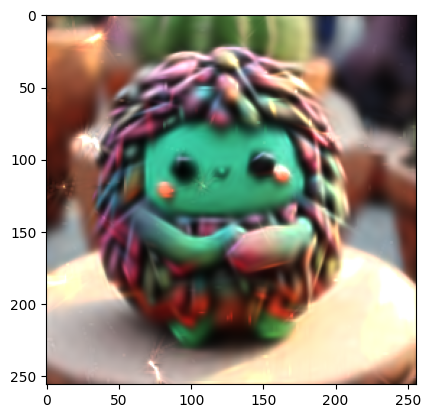

 18%|█▊        | 180/1000 [01:08<04:58,  2.75it/s]

Epoch 180 -> loss 0.03609299287199974


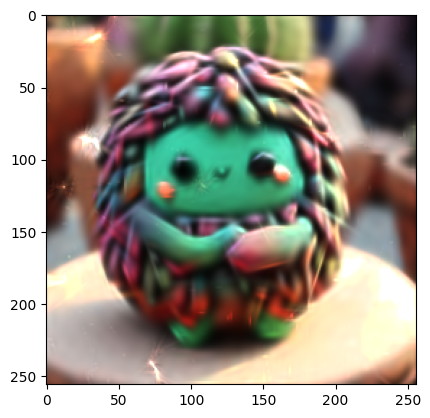

 19%|█▉        | 190/1000 [01:12<04:55,  2.75it/s]

Epoch 190 -> loss 0.035477422177791595


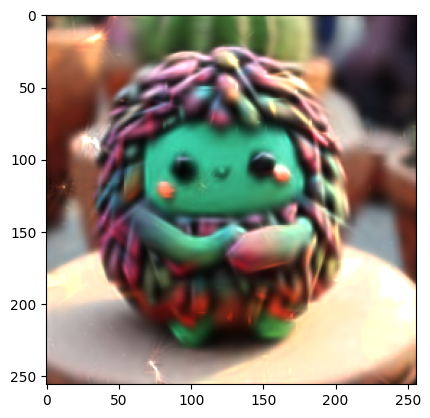

 20%|██        | 200/1000 [01:16<04:51,  2.75it/s]

Epoch 200 -> loss 0.034957155585289


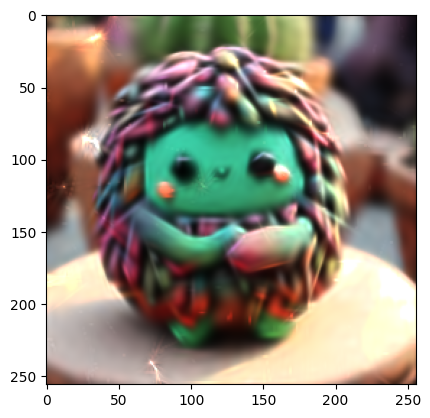

 21%|██        | 210/1000 [01:20<04:47,  2.75it/s]

Epoch 210 -> loss 0.03447436913847923


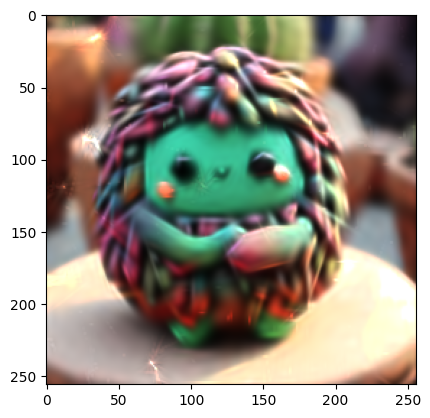

 22%|██▏       | 220/1000 [01:23<04:43,  2.75it/s]

Epoch 220 -> loss 0.03398967161774635


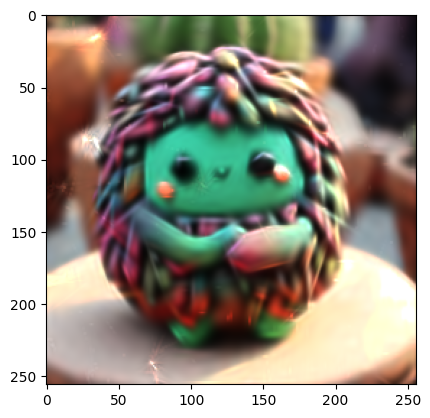

 23%|██▎       | 230/1000 [01:27<04:40,  2.75it/s]

Epoch 230 -> loss 0.033589836210012436


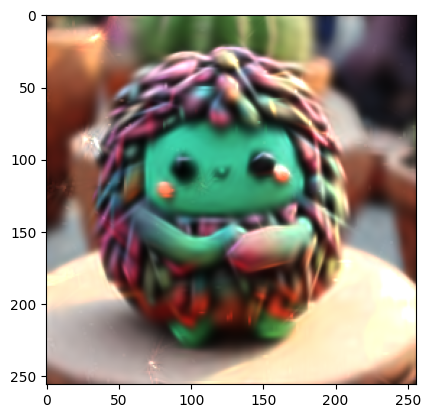

 24%|██▍       | 240/1000 [01:31<04:35,  2.76it/s]

Epoch 240 -> loss 0.033249519765377045


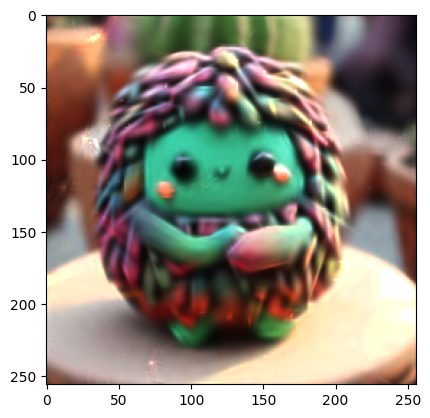

 25%|██▌       | 250/1000 [01:35<04:32,  2.75it/s]

Epoch 250 -> loss 0.03283996507525444


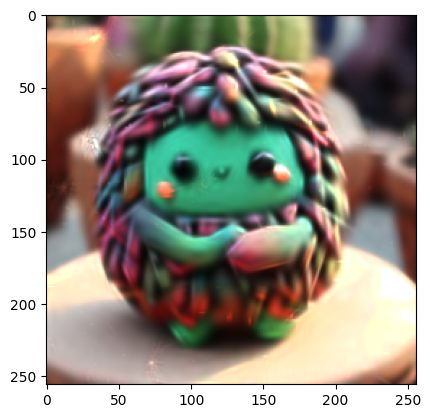

 26%|██▌       | 260/1000 [01:38<04:28,  2.75it/s]

Epoch 260 -> loss 0.032507121562957764


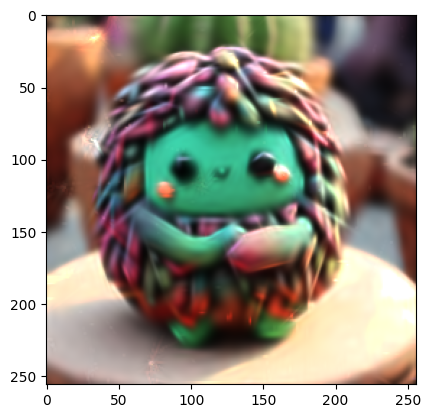

 27%|██▋       | 270/1000 [01:42<04:24,  2.76it/s]

Epoch 270 -> loss 0.03209979459643364


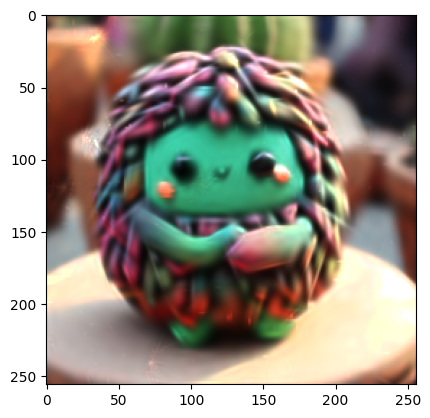

 28%|██▊       | 280/1000 [01:46<04:21,  2.75it/s]

Epoch 280 -> loss 0.03191782906651497


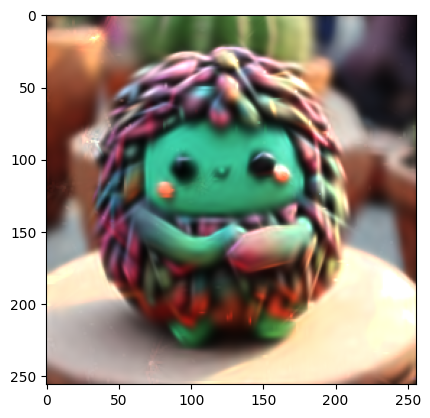

 29%|██▉       | 290/1000 [01:50<04:17,  2.75it/s]

Epoch 290 -> loss 0.031586091965436935


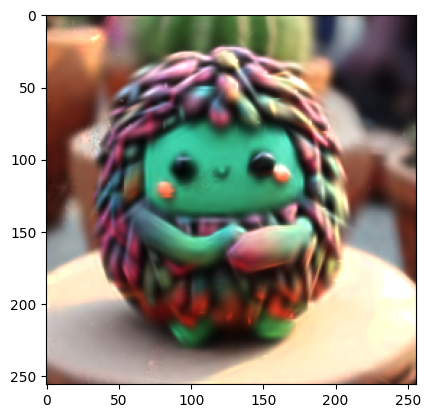

 30%|███       | 300/1000 [01:54<04:14,  2.75it/s]

Epoch 300 -> loss 0.03133763372898102


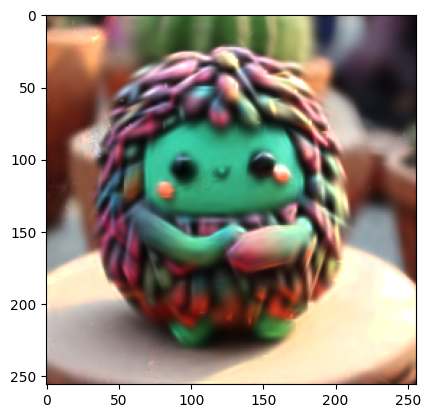

 31%|███       | 310/1000 [01:57<04:10,  2.75it/s]

Epoch 310 -> loss 0.031112447381019592


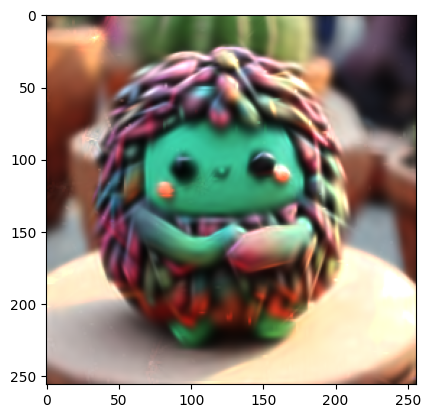

 32%|███▏      | 320/1000 [02:01<04:06,  2.76it/s]

Epoch 320 -> loss 0.030924547463655472


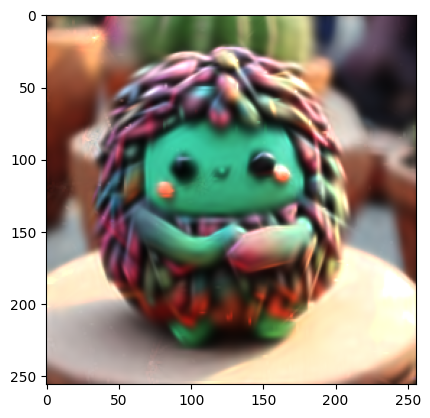

 33%|███▎      | 330/1000 [02:05<04:04,  2.74it/s]

Epoch 330 -> loss 0.03069935366511345


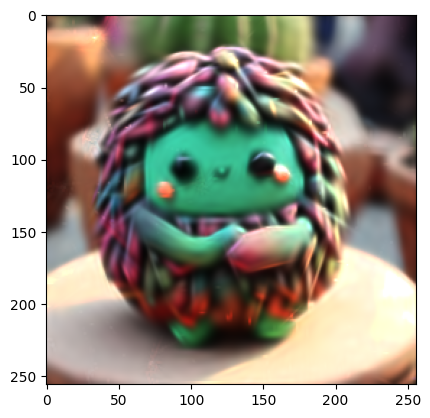

 34%|███▍      | 340/1000 [02:09<03:59,  2.75it/s]

Epoch 340 -> loss 0.030531715601682663


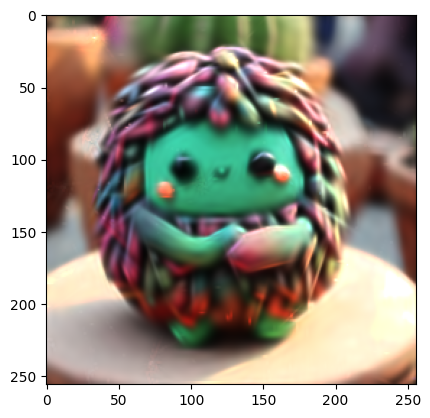

 35%|███▌      | 350/1000 [02:12<03:56,  2.75it/s]

Epoch 350 -> loss 0.03030882030725479


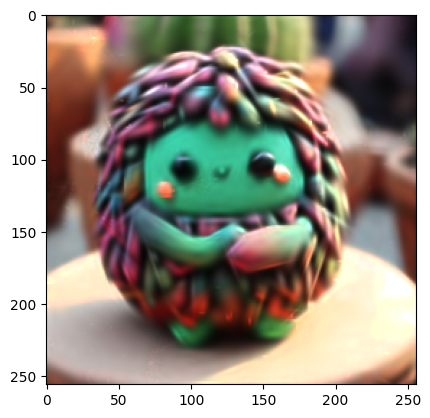

 36%|███▌      | 360/1000 [02:16<03:52,  2.75it/s]

Epoch 360 -> loss 0.030128568410873413


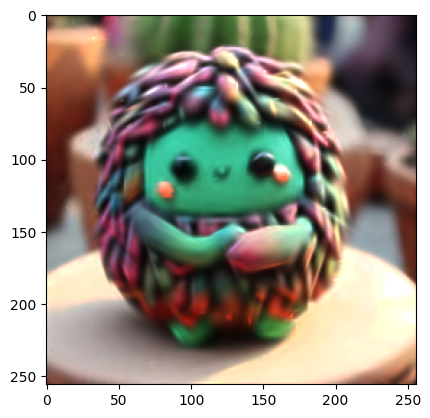

 37%|███▋      | 370/1000 [02:20<03:48,  2.75it/s]

Epoch 370 -> loss 0.029931198805570602


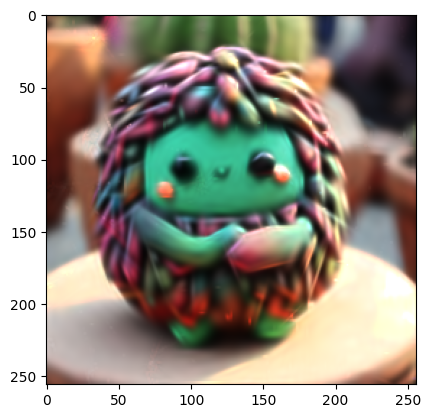

 38%|███▊      | 380/1000 [02:24<03:45,  2.75it/s]

Epoch 380 -> loss 0.0297270268201828


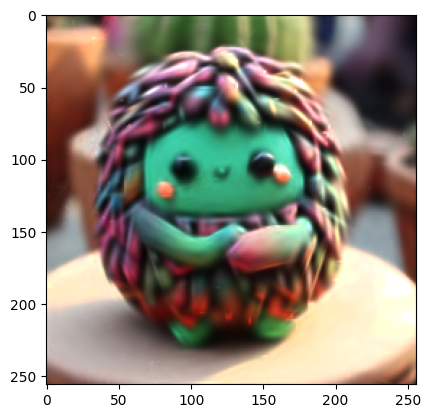

 39%|███▉      | 390/1000 [02:28<03:41,  2.75it/s]

Epoch 390 -> loss 0.02958199754357338


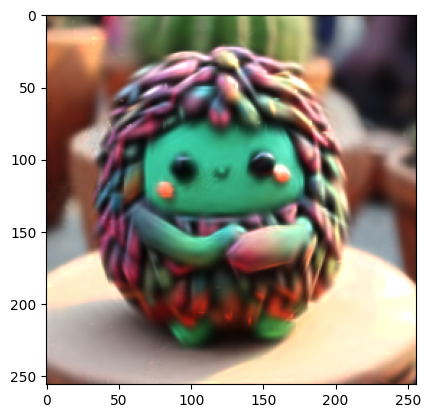

 40%|████      | 400/1000 [02:31<03:37,  2.75it/s]

Epoch 400 -> loss 0.029416784644126892


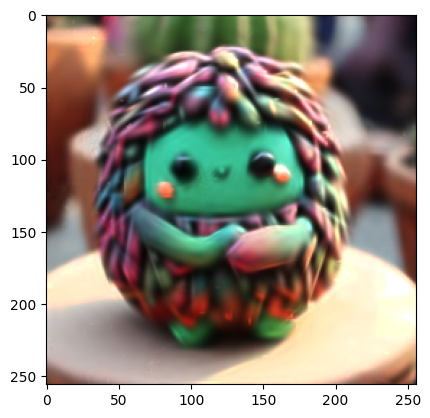

 41%|████      | 410/1000 [02:35<03:34,  2.75it/s]

Epoch 410 -> loss 0.02930956333875656


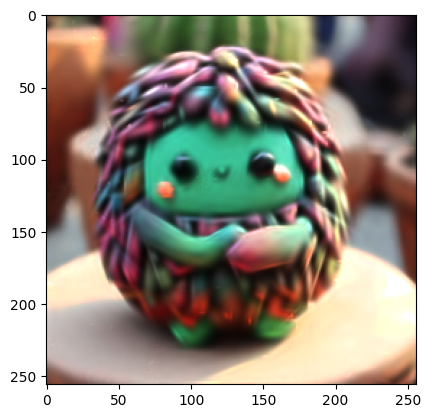

 42%|████▏     | 420/1000 [02:39<03:30,  2.75it/s]

Epoch 420 -> loss 0.029195260256528854


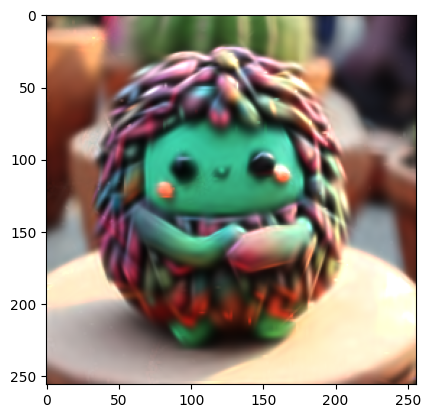

 43%|████▎     | 430/1000 [02:43<03:27,  2.75it/s]

Epoch 430 -> loss 0.029103446751832962


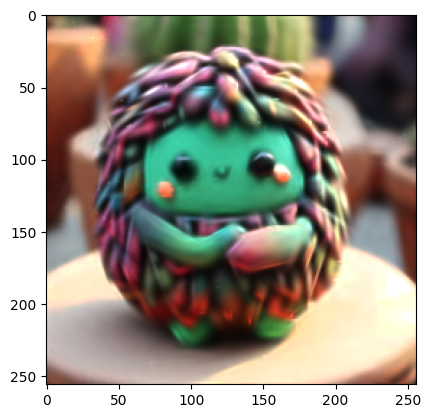

 44%|████▍     | 440/1000 [02:46<03:23,  2.75it/s]

Epoch 440 -> loss 0.028985481709241867


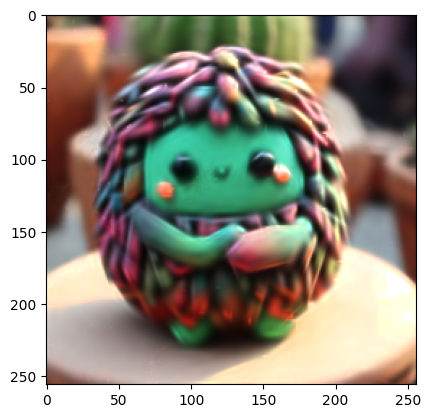

 45%|████▌     | 450/1000 [02:50<03:20,  2.75it/s]

Epoch 450 -> loss 0.0288187637925148


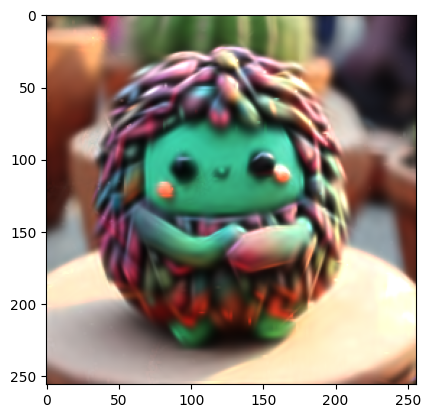

 46%|████▌     | 460/1000 [02:54<03:16,  2.75it/s]

Epoch 460 -> loss 0.0287589393556118


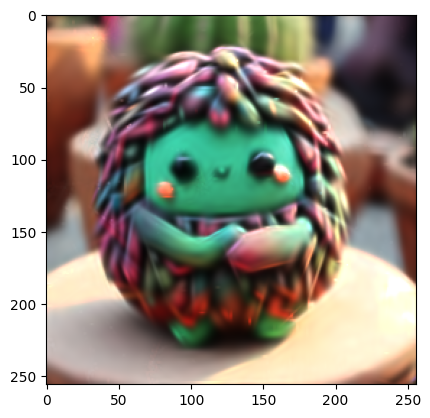

 47%|████▋     | 470/1000 [02:58<03:12,  2.75it/s]

Epoch 470 -> loss 0.02857942506670952


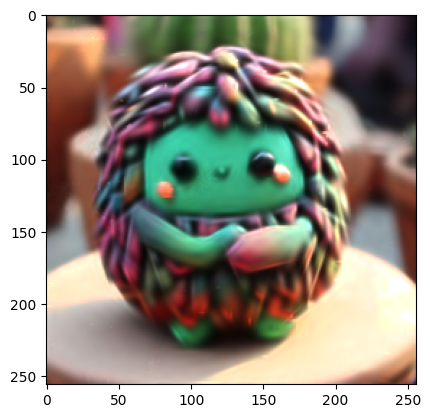

 48%|████▊     | 480/1000 [03:02<03:09,  2.75it/s]

Epoch 480 -> loss 0.028537055477499962


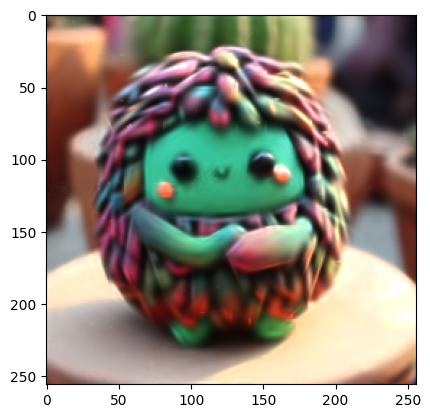

 49%|████▉     | 490/1000 [03:05<03:05,  2.75it/s]

Epoch 490 -> loss 0.02847358211874962


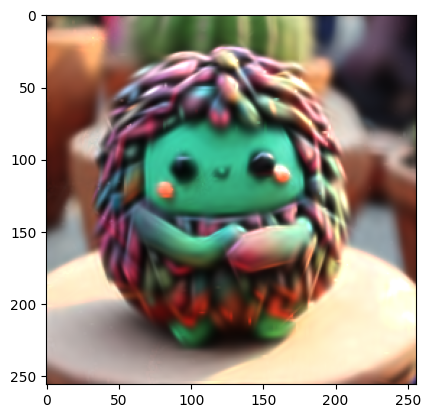

 50%|█████     | 500/1000 [03:09<03:01,  2.75it/s]

Epoch 500 -> loss 0.028347384184598923


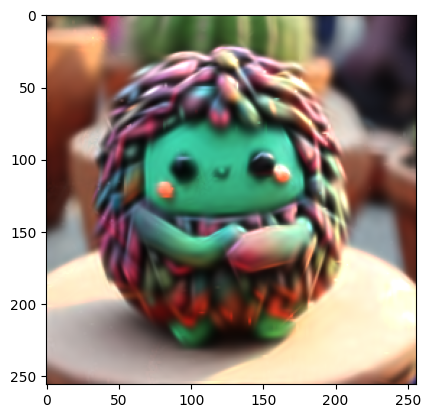

 51%|█████     | 510/1000 [03:13<02:58,  2.74it/s]

Epoch 510 -> loss 0.028214210644364357


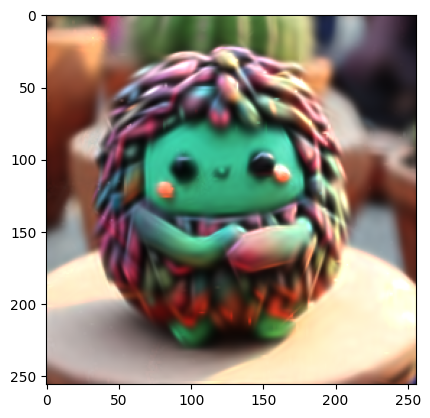

 52%|█████▏    | 520/1000 [03:17<02:54,  2.75it/s]

Epoch 520 -> loss 0.028046268969774246


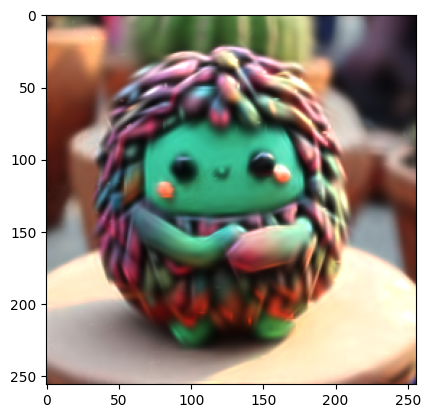

 53%|█████▎    | 530/1000 [03:21<02:50,  2.76it/s]

Epoch 530 -> loss 0.02793511003255844


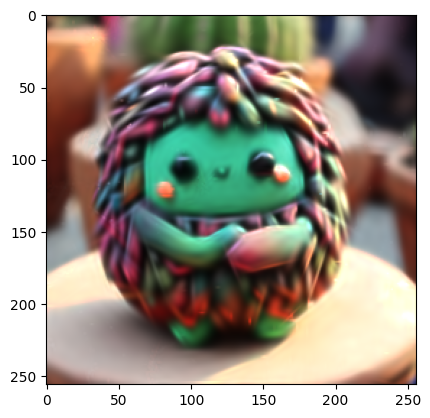

 54%|█████▍    | 540/1000 [03:24<02:46,  2.76it/s]

Epoch 540 -> loss 0.02785588800907135


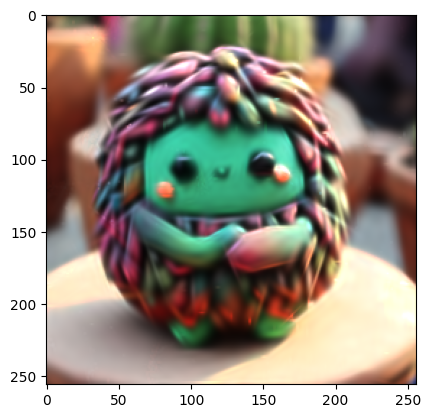

 55%|█████▌    | 550/1000 [03:28<02:43,  2.75it/s]

Epoch 550 -> loss 0.027733899652957916


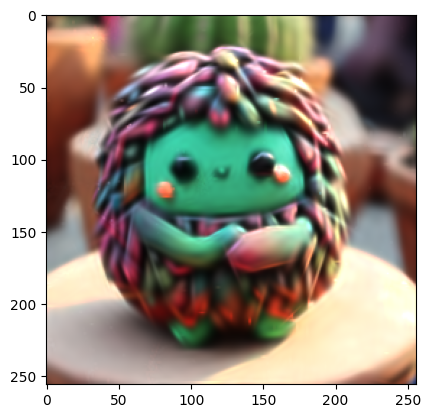

 56%|█████▌    | 560/1000 [03:32<02:40,  2.75it/s]

Epoch 560 -> loss 0.027594782412052155


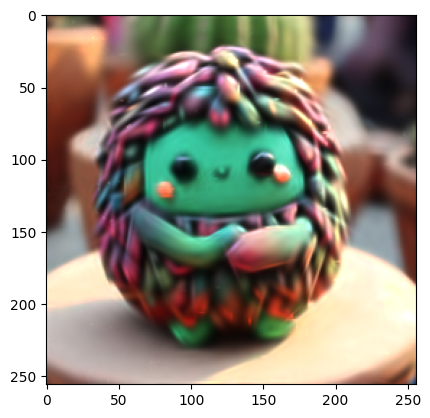

 57%|█████▋    | 570/1000 [03:36<02:36,  2.75it/s]

Epoch 570 -> loss 0.027560889720916748


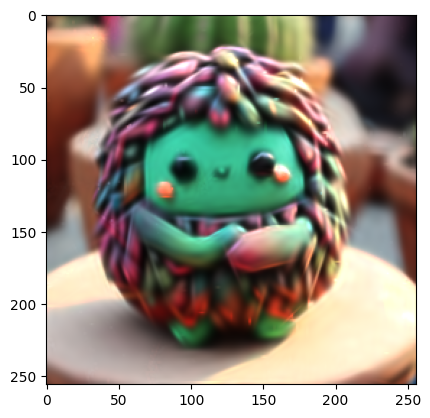

 58%|█████▊    | 580/1000 [03:40<02:32,  2.75it/s]

Epoch 580 -> loss 0.027522556483745575


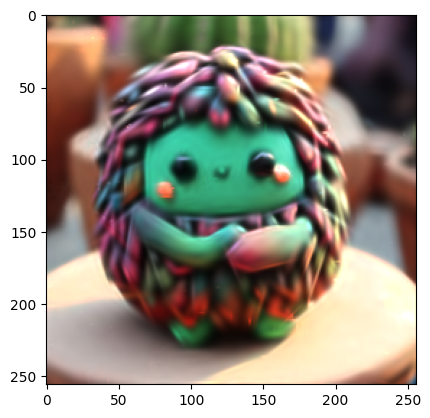

 59%|█████▉    | 590/1000 [03:43<02:28,  2.75it/s]

Epoch 590 -> loss 0.027440983802080154


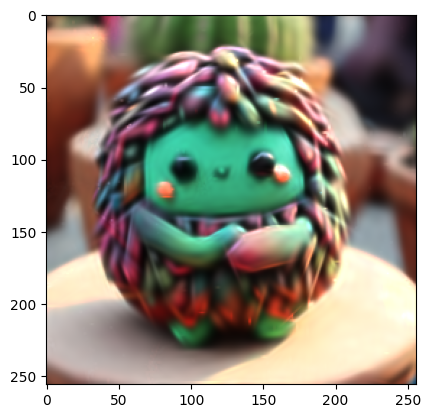

 60%|██████    | 600/1000 [03:47<02:25,  2.75it/s]

Epoch 600 -> loss 0.02733166515827179


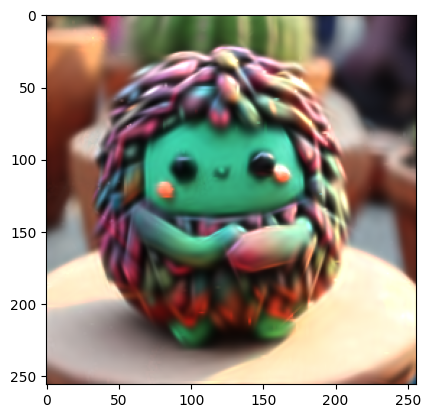

 61%|██████    | 610/1000 [03:51<02:21,  2.75it/s]

Epoch 610 -> loss 0.027263350784778595


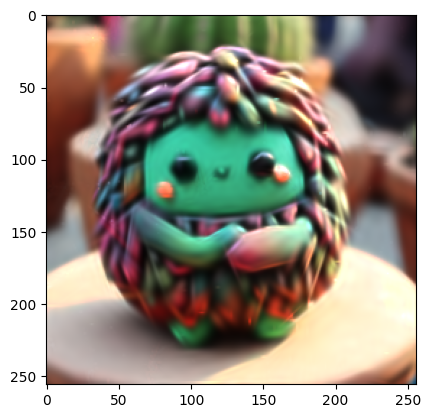

 62%|██████▏   | 620/1000 [03:55<02:18,  2.75it/s]

Epoch 620 -> loss 0.02718990296125412


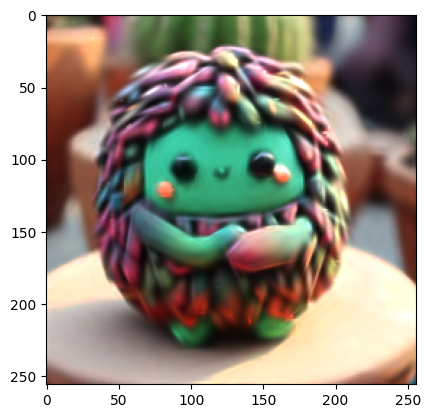

 63%|██████▎   | 630/1000 [03:58<02:14,  2.75it/s]

Epoch 630 -> loss 0.02712041139602661


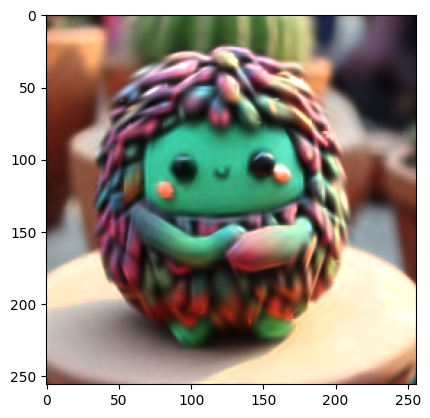

 64%|██████▍   | 640/1000 [04:02<02:10,  2.75it/s]

Epoch 640 -> loss 0.02707495167851448


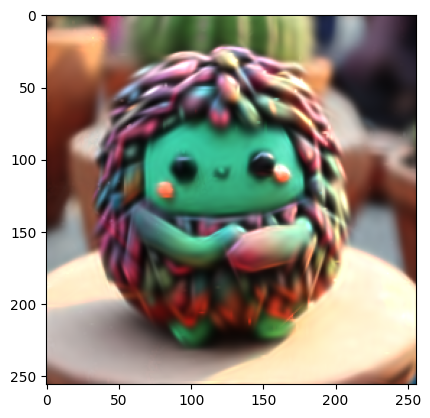

 65%|██████▌   | 650/1000 [04:06<02:06,  2.76it/s]

Epoch 650 -> loss 0.027010556310415268


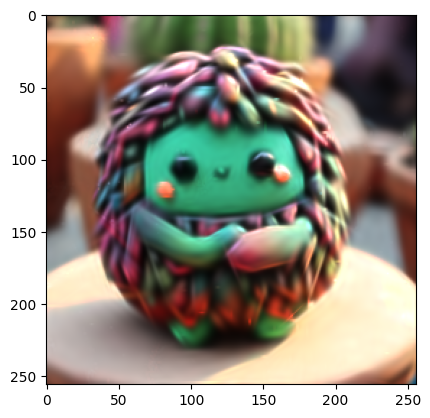

 66%|██████▌   | 660/1000 [04:10<02:03,  2.76it/s]

Epoch 660 -> loss 0.026969512924551964


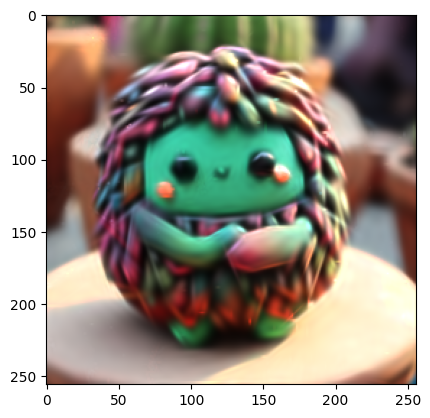

 67%|██████▋   | 670/1000 [04:13<02:00,  2.75it/s]

Epoch 670 -> loss 0.026889728382229805


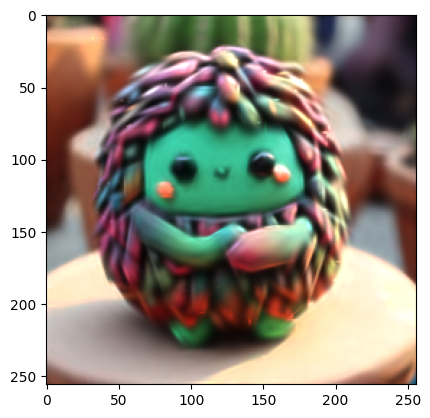

 68%|██████▊   | 680/1000 [04:17<01:56,  2.75it/s]

Epoch 680 -> loss 0.02685679867863655


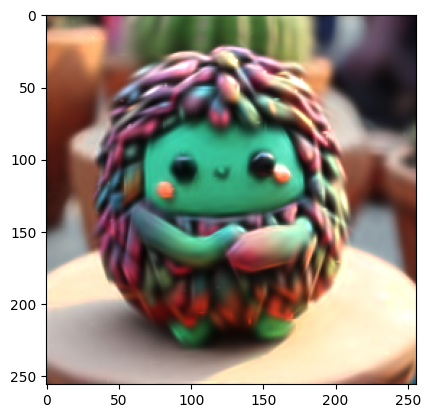

 69%|██████▉   | 690/1000 [04:21<01:52,  2.75it/s]

Epoch 690 -> loss 0.026813682168722153


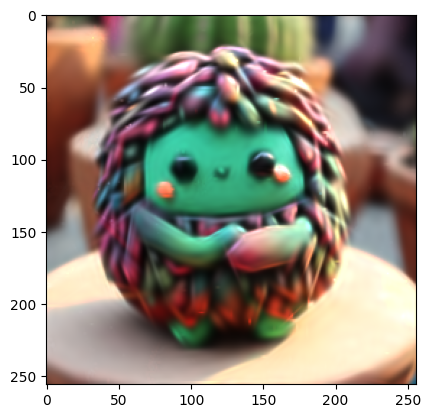

 70%|███████   | 700/1000 [04:25<01:49,  2.75it/s]

Epoch 700 -> loss 0.026754658669233322


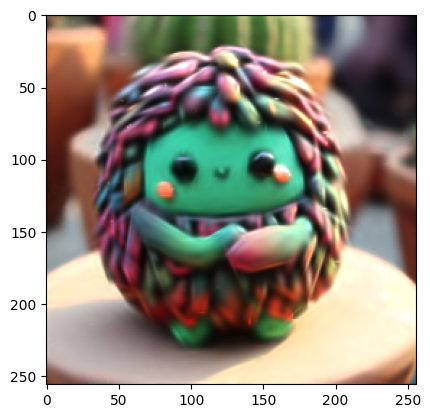

 71%|███████   | 710/1000 [04:29<01:45,  2.75it/s]

Epoch 710 -> loss 0.026700954884290695


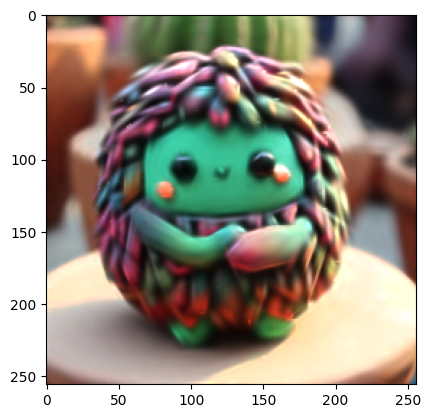

 72%|███████▏  | 720/1000 [04:32<01:41,  2.75it/s]

Epoch 720 -> loss 0.026621973142027855


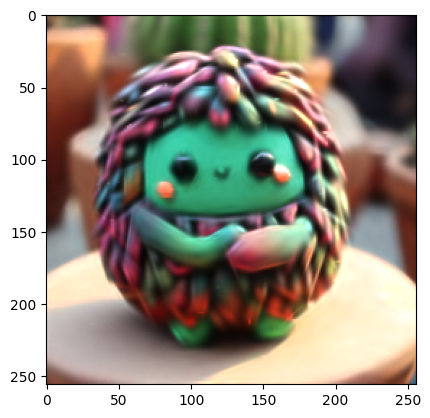

 73%|███████▎  | 730/1000 [04:36<01:37,  2.76it/s]

Epoch 730 -> loss 0.026550322771072388


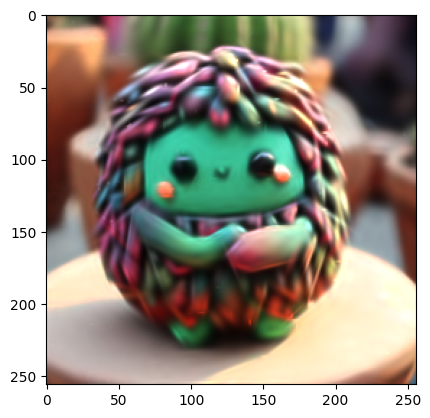

 74%|███████▍  | 740/1000 [04:40<01:34,  2.76it/s]

Epoch 740 -> loss 0.026527291163802147


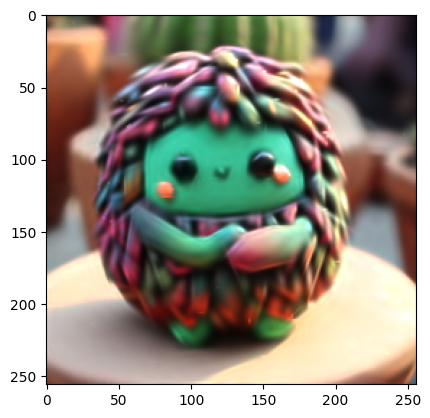

 75%|███████▌  | 750/1000 [04:44<01:30,  2.76it/s]

Epoch 750 -> loss 0.026468779891729355


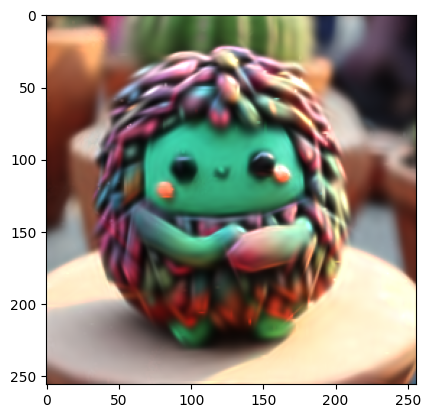

 76%|███████▌  | 760/1000 [04:47<01:27,  2.75it/s]

Epoch 760 -> loss 0.026474865153431892


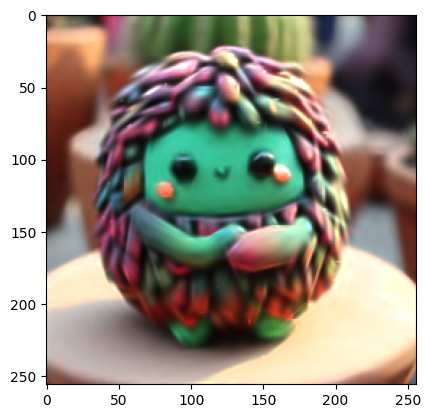

 77%|███████▋  | 770/1000 [04:51<01:23,  2.75it/s]

Epoch 770 -> loss 0.026368729770183563


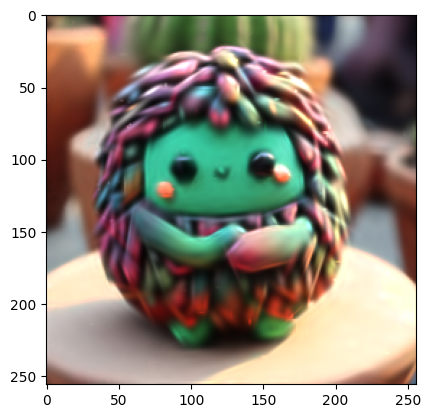

 78%|███████▊  | 780/1000 [04:55<01:20,  2.75it/s]

Epoch 780 -> loss 0.02636871114373207


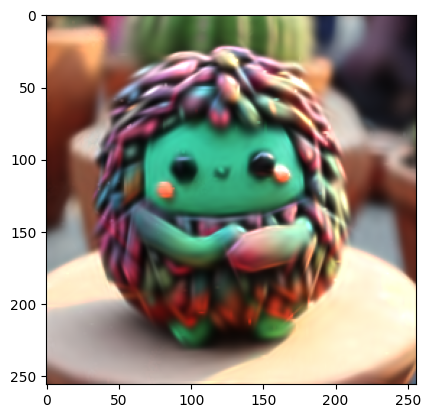

 79%|███████▉  | 790/1000 [04:59<01:16,  2.75it/s]

Epoch 790 -> loss 0.026301532983779907


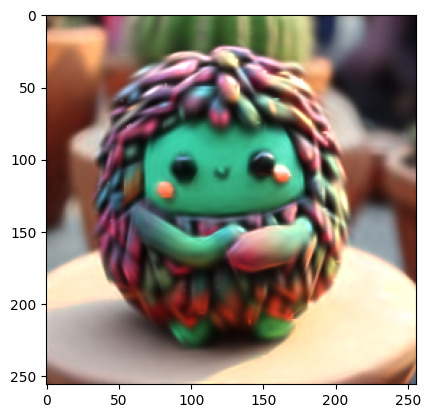

 80%|████████  | 800/1000 [05:03<01:12,  2.75it/s]

Epoch 800 -> loss 0.026253391057252884


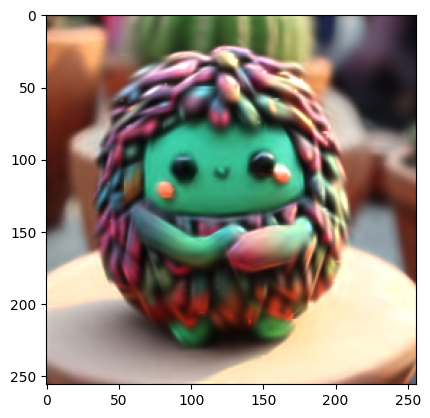

 81%|████████  | 810/1000 [05:06<01:09,  2.74it/s]

Epoch 810 -> loss 0.026219602674245834


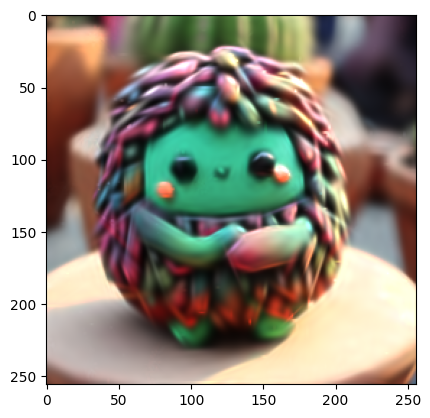

 82%|████████▏ | 820/1000 [05:10<01:05,  2.75it/s]

Epoch 820 -> loss 0.026194540783762932


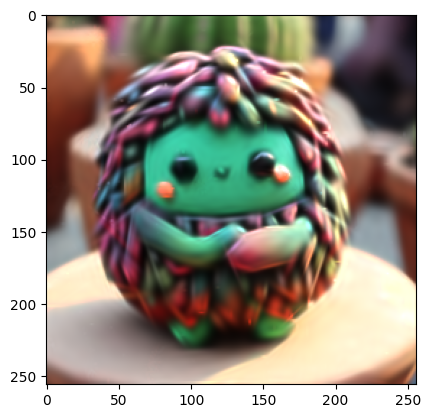

 83%|████████▎ | 830/1000 [05:14<01:01,  2.75it/s]

Epoch 830 -> loss 0.026133529841899872


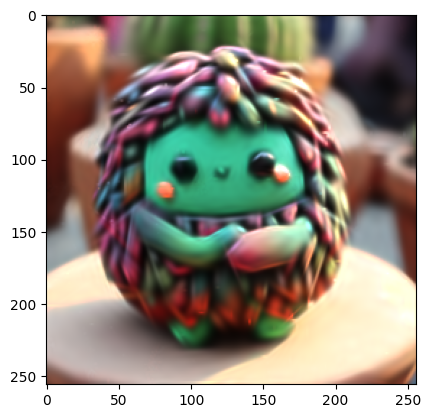

 84%|████████▍ | 840/1000 [05:18<00:58,  2.76it/s]

Epoch 840 -> loss 0.026094868779182434


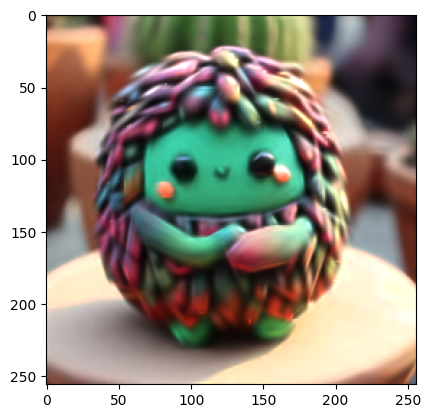

 85%|████████▌ | 850/1000 [05:21<00:54,  2.76it/s]

Epoch 850 -> loss 0.0260842926800251


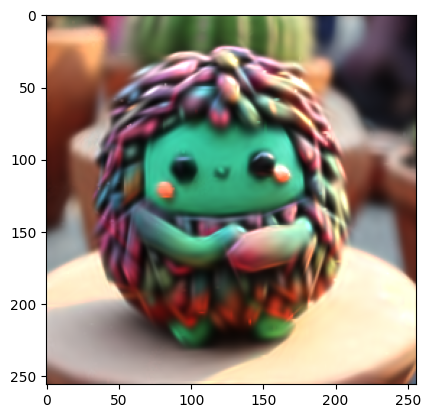

 86%|████████▌ | 860/1000 [05:25<00:50,  2.75it/s]

Epoch 860 -> loss 0.0260525681078434


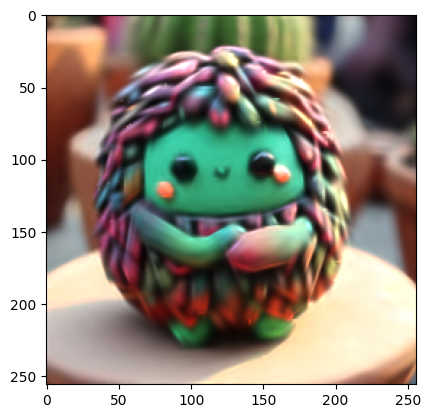

 87%|████████▋ | 870/1000 [05:29<00:47,  2.75it/s]

Epoch 870 -> loss 0.026064619421958923


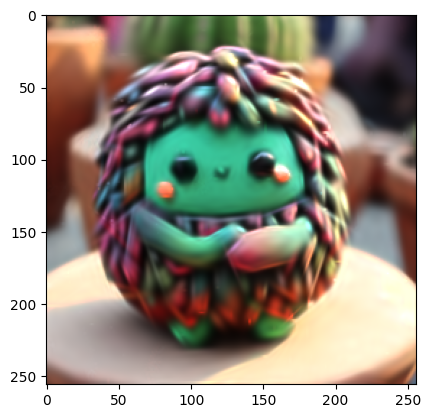

 88%|████████▊ | 880/1000 [05:33<00:43,  2.75it/s]

Epoch 880 -> loss 0.02599160373210907


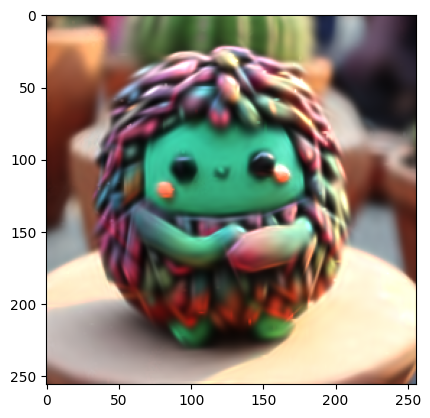

 89%|████████▉ | 890/1000 [05:37<00:39,  2.75it/s]

Epoch 890 -> loss 0.02602824568748474


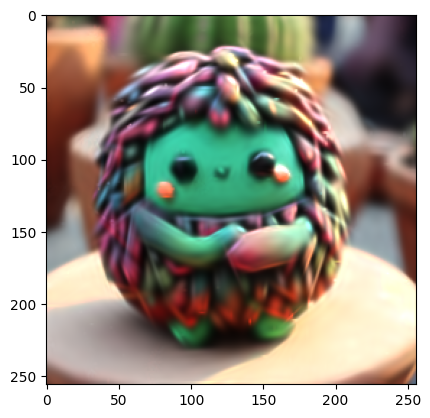

 90%|█████████ | 900/1000 [05:40<00:36,  2.76it/s]

Epoch 900 -> loss 0.025935804471373558


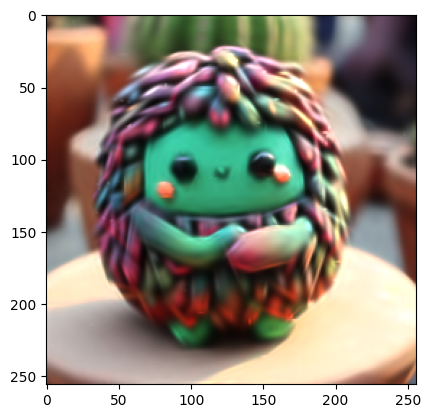

 91%|█████████ | 910/1000 [05:44<00:32,  2.76it/s]

Epoch 910 -> loss 0.025871600955724716


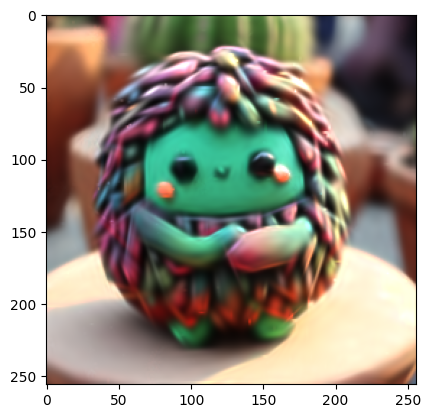

 92%|█████████▏| 920/1000 [05:48<00:29,  2.75it/s]

Epoch 920 -> loss 0.025765303522348404


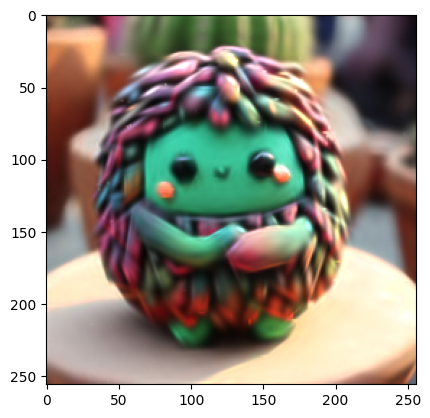

 93%|█████████▎| 930/1000 [05:52<00:25,  2.75it/s]

Epoch 930 -> loss 0.025824008509516716


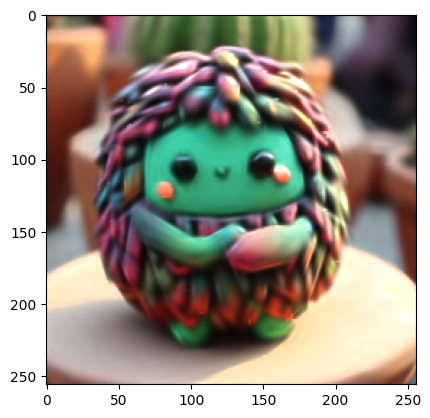

 94%|█████████▍| 940/1000 [05:56<00:21,  2.75it/s]

Epoch 940 -> loss 0.025757459923624992


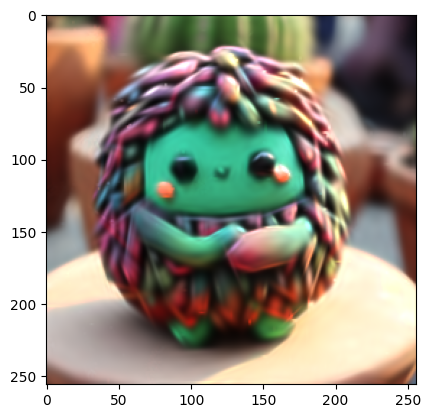

 95%|█████████▌| 950/1000 [05:59<00:18,  2.75it/s]

Epoch 950 -> loss 0.02574697509407997


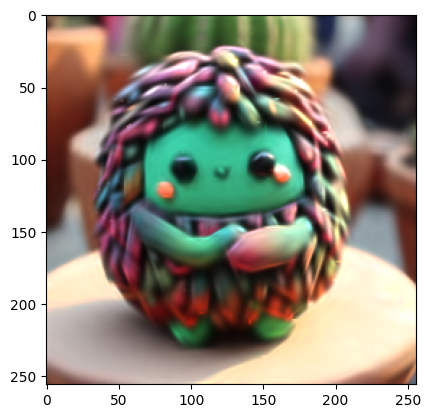

 96%|█████████▌| 960/1000 [06:03<00:14,  2.75it/s]

Epoch 960 -> loss 0.025694767013192177


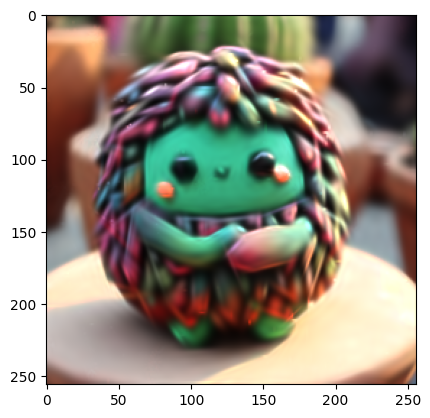

 97%|█████████▋| 970/1000 [06:07<00:10,  2.75it/s]

Epoch 970 -> loss 0.02565683238208294


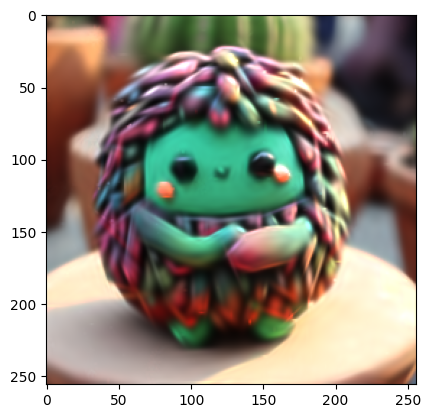

 98%|█████████▊| 980/1000 [06:11<00:07,  2.76it/s]

Epoch 980 -> loss 0.025560539215803146


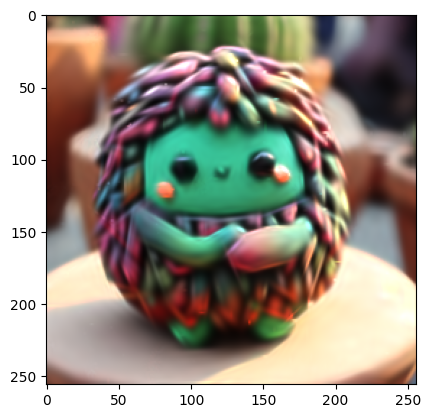

 99%|█████████▉| 990/1000 [06:14<00:03,  2.75it/s]

Epoch 990 -> loss 0.025530315935611725


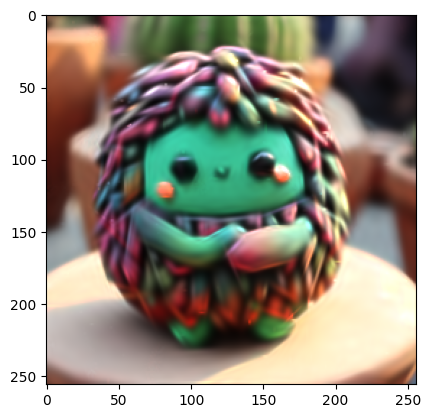

100%|██████████| 1000/1000 [06:18<00:00,  2.64it/s]


In [20]:
for epoch in tqdm(range(1000)):

    gaussian_variables = W
    predicted = sample_gaussians(gaussian_variables)
    loss = combined_loss(predicted, image_tensor, lambda_param=0.2)

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    loss_history.append(loss.item())

    if(epoch % 10 == 0):
        print(f"Epoch {epoch} -> loss {loss.item()}")
        plt.imshow(predicted.detach().to('cpu').numpy())
        plt.show()

(array([ 54., 170., 152., 155., 103., 116., 153.,  52.,  41.,   4.]),
 array([0.11733955, 0.3711462 , 0.62495285, 0.8787595 , 1.13256609,
        1.3863728 , 1.6401794 , 1.89398611, 2.14779282, 2.40159941,
        2.655406  ]),
 <BarContainer object of 10 artists>)

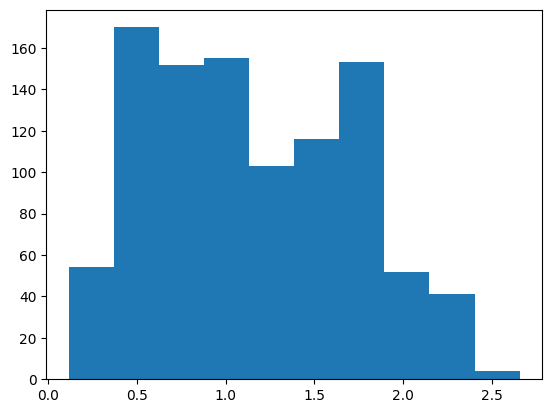

In [19]:
params = W.detach().to("cpu").numpy()
params.shape

import matplotlib.pyplot as plt

plt.hist(params[:, 3])